In [1]:
import pandas as pd

In [2]:
import numpy as np
import re

In [3]:
df=pd.read_csv('imdb.csv')

In [4]:
df.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [5]:
df['sentiment'].replace({'positive':1,'negative':0},inplace=True)

In [6]:
df.iloc[1:2,:]

,review,sentiment
1,A wonderful little production. <br /><br />The...,1


In [7]:
df['review_str']=df['review'].apply(lambda x:str(x))

In [8]:
df.duplicated().sum()

418

In [9]:
df.drop_duplicates(inplace=True)

In [10]:
df.shape

(49582, 3)

In [11]:
from matplotlib import pyplot as plt

<Axes: xlabel='sentiment'>

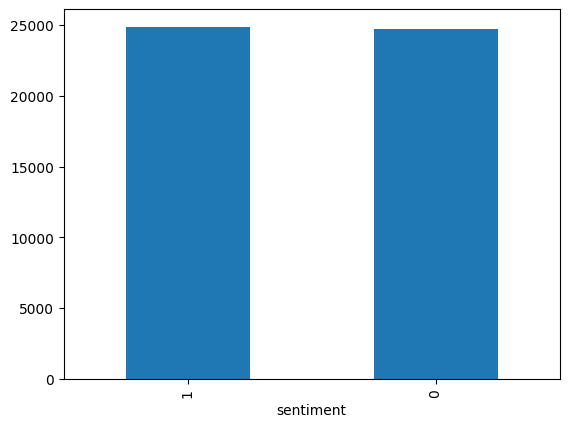

In [12]:
df['sentiment'].value_counts().plot(kind='bar')

In [13]:
all_text=' '.join(df['review'].values)

In [14]:
len(all_text)

65030175

In [15]:
all_text = re.sub(r'http\S+', '', all_text)
all_text = re.sub(r'@\S+', '', all_text)
all_text = re.sub(r'#\S+', '', all_text)

In [16]:
words = all_text.split()

In [17]:
len(words)

11470346

In [18]:
from sklearn.feature_extraction.text import TfidfVectorizer
from collections import Counter
from nltk.corpus import stopwords

In [19]:
!pip install -U nltk

In [20]:
stopwords.words('english')

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [21]:
nltk.download('stopwords')

NameError: name 'nltk' is not defined

In [ ]:
import nltk
for dependency in (
    "brown",
    "names",
    "wordnet",
    "averaged_perceptron_tagger",
    "universal_tagset",
):
    nltk.download(dependency)

In [ ]:
stop_words = set(stopwords.words('english'))
words = [word for word in words if not word in stop_words]

In [ ]:
# Count the frequency of each word
word_counts = Counter(words)
top_words = word_counts.most_common(100)
top_words

In [22]:
def remove_html_tags(text):
    re_html = re.compile('<.*?>')
    return re_html.sub(r'', text)



df['review'] = df['review'].apply(remove_html_tags)


In [23]:
def convert_lowercase(column):
    column = column.str.lower()
    return column



df['review'] = convert_lowercase(df['review'])


In [24]:
def remove_special_characters(text, remove_digits=True):
    pattern=r'[^a-zA-z0-9\s]'
    text=re.sub(pattern,'',text)
    return text



df['review']=df['review'].apply(remove_special_characters)

In [25]:
import nltk

In [26]:

from nltk.corpus import stopwords
stopwords_english = stopwords.words('english')

def remove_stopwords(text):
    stop_words = nltk.corpus.stopwords.words("english")
    text = " ".join([word for word in text.split() if word not in stop_words])
    
    return text



df['review'] = df['review'].apply(remove_stopwords)

In [27]:
def lemmatize(text):      
        text = text.split()
        lemmatizer = WordNetLemmatizer() 
        lemmatized_words = [lemmatizer.lemmatize(word) for word in text]
        text = " ".join(lemmatized_words)
        return text

In [28]:
from nltk.stem import WordNetLemmatizer 
from sklearn.model_selection import train_test_split

In [28]:
y=df['sentiment'].values
X_train, X_test, y_train, y_test = train_test_split(df['review'], y, test_size=0.2, random_state=42)

# Word2Vec Model
sentences = [review.split() for review in X_train]

In [29]:
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn import metrics
from sklearn.naive_bayes import GaussianNB,MultinomialNB
from sklearn import metrics
from gensim.models import Word2Vec
from sklearn.metrics import accuracy_score

In [69]:
!pip install gensim

     |████████████████████████████████| 26.5 MB 11.2 MB/s eta 0:00:01
     |████████████████████████████████| 56 kB 10.1 MB/s eta 0:00:01


In [73]:
# Custom Transformer for Word2Vec Word Embeddings
from sklearn.base import BaseEstimator, TransformerMixin
class Word2VecEmbeddingTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, word2vec_model):
        self.word2vec_model = word2vec_model

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        return np.array([self.get_word_embeddings(review) for review in X])

    def get_word_embeddings(self, text):
        words = text.split()
        embeddings = [self.word2vec_model.wv[word] for word in words if word in self.word2vec_model.wv]
        if len(embeddings) > 0:
            return np.mean(embeddings, axis=0)
        else:
            return np.zeros(100)



In [36]:
target.shape,em_arr.shape

((49582,), (49582, 1000))

In [37]:
target=target.reshape(target.shape[0],1)

In [39]:
x_t,x_test,y_t,y_test=train_test_split(em_arr,target,random_state=42,test_size=0.3)

In [40]:
x_t.shape

(34707, 1000)

In [47]:
y_t.reshape(y_t.shape[0])

array([0, 0, 0, ..., 0, 1, 1])

In [48]:
y_t.shape

(34707, 1)

In [43]:
x_t[:40].shape

(40, 1000)

In [50]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB

from sklearn.model_selection import GridSearchCV

models = {
    # 'Naive Bayes': (MultinomialNB(), {'alpha': [0.01, 0.1, 1.0]}),
    # 'Logistic Regression': (LogisticRegression(), {'C': [0.1, 1, 10]}),
    'Support Vector Machines': (SVC(), {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}),
    # 'Random Forest': (RandomForestClassifier(), {'n_estimators': [50, 100, 200]})
}

# Perform grid search for each model
for model_name, (model, param_grid) in models.items():
    grid_search = GridSearchCV(model, param_grid, cv=5, scoring='accuracy')
    grid_search.fit(x_t[:5000], y_t[:5000])
    
    print(f"Best parameters for {model_name}: {grid_search.best_params_}")
    print(f"Best accuracy for {model_name}: {grid_search.best_score_}\n")

/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/utils/validation.py:1184: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/studio-lab-user/.conda/envs/default/lib/python3.9/site-packages/sklearn/utils/validation.py:1184: DataConversionWar

Best parameters for Support Vector Machines: {'C': 1, 'kernel': 'rbf'}
Best accuracy for Support Vector Machines: 0.8371999999999999



In [32]:

def text_cleaning(text, remove_stop_words=True, lemmatize_words=True):
    ## Clean the text, with the option to remove stop_words and to lemmatize word
    ## Clean the text
    text = re.sub(r"[^A-Za-z0-9]", " ", text)
    text = re.sub(r"\'s", " ", text)
    text = re.sub(r"http\S+", " link ", text)
    text = re.sub(r"\b\d+(?:\.\d+)?\s+", "", text)  ## remove numbers
    ## Remove punctuation from text
    text = "".join([c for c in text if c not in punctuation])
    ## Optionally, remove stop words
    if remove_stop_words:
        ## load stopwords
        stop_words = stopwords.words("english")
        text = text.split()
        text = [w for w in text if not w in stop_words]
        text = " ".join(text)
    ## Optionally, shorten words to their stems
    if lemmatize_words:
        text = text.split()
        lemmatizer = WordNetLemmatizer()
        lemmatized_words = [lemmatizer.lemmatize(word) for word in text]
        text = " ".join(lemmatized_words)
    ## Return a list of words
    return text

In [33]:
from string import punctuation
text_cleaning('<h1>movie 1 and 2 are really good !!!</h1>')

'h1 movie really good h1'

In [93]:
tfidf_pipeline.predict(['movie is very boaring and sad ','moving is not good'])

array([0, 1])

In [34]:
df

,review,sentiment,review_str
0,one reviewers mentioned watching 1 oz episode ...,1,One of the other reviewers has mentioned that ...
1,wonderful little production filming technique ...,1,A wonderful little production. <br /><br />The...
2,thought wonderful way spend time hot summer we...,1,I thought this was a wonderful way to spend ti...
3,basically theres family little boy jake thinks...,0,Basically there's a family where a little boy ...
4,petter matteis love time money visually stunni...,1,"Petter Mattei's ""Love in the Time of Money"" is..."
...,...,...,...
49995,thought movie right good job wasnt creative or...,1,I thought this movie did a down right good job...
49996,bad plot bad dialogue bad acting idiotic direc...,0,"Bad plot, bad dialogue, bad acting, idiotic di..."
49997,catholic taught parochial elementary schools n...,0,I am a Catholic taught in parochial elementary...
49998,im going disagree previous comment side maltin...,0,I'm going to have to disagree with the previou...


In [29]:
embedder= TfidfVectorizer(max_df=0.90, min_df=2, max_features=1000, stop_words='english')

In [30]:
embedding=embedder.fit_transform(df['review'].values)

In [31]:
embedding.shape

(49582, 1000)

In [32]:
embedding[0][0]

<1x1000 sparse matrix of type '<class 'numpy.float64'>'
	with 50 stored elements in Compressed Sparse Row format>

In [33]:
type(embedding)

scipy.sparse._csr.csr_matrix

In [34]:
em_arr=embedding.toarray()

In [41]:
em_arr.shape

(49582, 1000)

In [42]:
from sklearn.decomposition import PCA

In [43]:
pca=PCA(n_components=3)

In [44]:
pca_arr=pca.fit_transform(em_arr)

In [45]:
pca_arr

array([[-0.0390282 , -0.12284371,  0.07680668],
       [-0.06001207, -0.11088561, -0.01674801],
       [-0.02526558, -0.09403051,  0.00991498],
       ...,
       [-0.00425078, -0.07518867,  0.02963674],
       [-0.06156012, -0.08027287,  0.03720726],
       [ 0.33258955,  0.08065988, -0.12046045]])

In [35]:
target=df['sentiment'].values

In [47]:
pca_arr[target==0]

array([[ 0.01909392, -0.00513293, -0.05261367],
       [-0.00448024, -0.05966249,  0.11457235],
       [-0.16831596,  0.2012627 ,  0.04865149],
       ...,
       [-0.00425078, -0.07518867,  0.02963674],
       [-0.06156012, -0.08027287,  0.03720726],
       [ 0.33258955,  0.08065988, -0.12046045]])

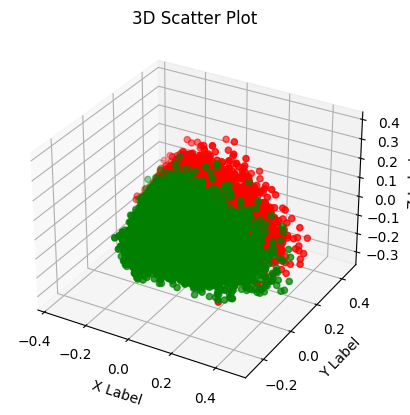

In [48]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Create sample data
x = pca_arr[target==0][:,:1]
y = pca_arr[target==0][:,1:2]
z = pca_arr[target==0][:,2:3]


a = pca_arr[target==1][:,:1]
b = pca_arr[target==1][:,1:2]
c = pca_arr[target==1][:,2:3]


# Create a figure and 3D axis
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Create scatter plot
ax.scatter(x, y, z, c='r', marker='o',label='negative')
ax.scatter(a,b,c, c='g', marker='o',label='positive')

# Set labels for each axis
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Set plot title
ax.set_title('3D Scatter Plot')

# Show the plot
plt.show()


In [49]:
!pip install plotly


In [50]:
import plotly.graph_objects as go

In [51]:
trace1 = go.Scatter3d(
    x=x, y=y, z=z,
    mode='markers',
    marker=dict(color='red', size=5),
    name='Class 1'
)

trace2 = go.Scatter3d(
    x=a, y=b, z=c,
    mode='markers',
    marker=dict(color='blue', size=5),
    name='Class 2'
)

# Layout settings
layout = go.Layout(
    scene=dict(
        xaxis_title='X Label',
        yaxis_title='Y Label',
        zaxis_title='Z Label'
    ),
    title='3D Scatter Plot'
)
fig = go.Figure(data=[trace1, trace2], layout=layout)

# Show the plot
fig.show()
print('plotted')

plotted
